In [1]:
import torch
import numpy as np
from PIL import Image, ImageDraw, ImageFont, ImageOps, ImageEnhance
import matplotlib.pyplot as plt

In [2]:
def qint8(m, per_channel=True, inplace=False):
    qconfig_spec = {torch.nn.Linear: (torch.quantization.per_channel_dynamic_qconfig if per_channel else torch.quantization.default_dynamic_qconfig)}
    return torch.quantization.quantize_dynamic(m, qconfig_spec=qconfig_spec, dtype=torch.qint8, inplace=inplace)

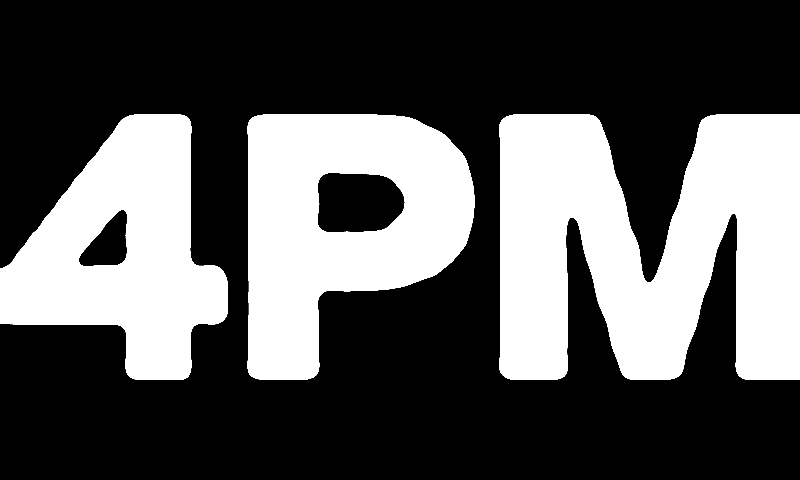

In [3]:
from datetime import datetime, timedelta

#epoch_seconds = int(datetime.now().timestamp())
#current_time = datetime.now(beautiful_downtown_oakland_california).strftime("%d%b").upper().strip('0')
ptsans = ImageFont.truetype("pt-sans-narrow-regular.ttf",50)
atkbold = ImageFont.truetype("Atkinson-Hyperlegible-Bold-102.otf",50)
atkreg = ImageFont.truetype("Atkinson-Hyperlegible-Regular-102.otf",50)
mask_text = "4PM"
#image_size = (768, 432)
image_size = (800, 480)
inference_steps = 2

def mask_image_factory(timestamp, mask_text=None):
    is_two_line = False # our images are 4:3 instead of 1:1, so we have space for all on one line
    linesep = "\n" if is_two_line else ""
    if mask_text is None:
        mask_text = timestamp.strftime(f"%-I{linesep}%p").upper() if timestamp.minute == 0 else timestamp.strftime(f"%-I{linesep}%M")
    time_img = Image.new("L", image_size, (0,))
    draw = ImageDraw.Draw(time_img)
    draw.multiline_text(
        xy=(0,0),
        text=mask_text,
        fill=(255,),
        font=atkbold,
        align="center",
        spacing=-10,
    )
    cropped = time_img.crop(time_img.getbbox())

    # Calculate aspect ratios
    image_aspect_ratio = image_size[0] / image_size[1]
    cropped_aspect_ratio = cropped.size[0] / cropped.size[1]

    # Determine which dimension of cropped.size is larger
    if cropped_aspect_ratio > image_aspect_ratio:
        # Calculate new dimensions for padding
        new_width = int(cropped.size[1] * image_aspect_ratio)
        new_height = cropped.size[1]
    else:
        new_width = cropped.size[0]
        new_height = int(cropped.size[0] / image_aspect_ratio)

    # Pad the image to the desired aspect ratio
    padded = ImageOps.pad(cropped, (new_width, new_height))

    resized = padded.resize(image_size, resample=Image.Resampling.LANCZOS)
    enhanced_image = ImageEnhance.Contrast(resized).enhance(9000)
    return enhanced_image

mask_image = mask_image_factory(datetime(year=1,month=1,day=1,hour=16))
mask_image

In [5]:
preferred_dtype = torch.float32
preferred_device = "mps" if torch.backends.mps.is_available() else "cpu"
preferred_device = "cpu"
torch.backends.quantized.engine = "qnnpack"
unet_preferred_dtype = torch.qint8

In [6]:
from diffusers import StableDiffusionXLControlNetPipeline, StableDiffusionXLPipeline, StableDiffusionControlNetPipeline, ControlNetModel, LCMScheduler, DiffusionPipeline
from diffusers.models.attention_processor import SlicedAttnProcessor

from diffusers.utils import load_image, make_image_grid


In [7]:
controlnet = ControlNetModel.from_pretrained(
    "monster-labs/control_v1p_sd15_qrcode_monster",
#    "monster-labs/control_v1p_sdxl_qrcode_monster",
#    "lllyasviel/sd-controlnet-canny",
#    "diffusers/controlnet-canny-sdxl-1.0",
    #subfolder="v2",
    torch_dtype=preferred_dtype,
    #torch_dtype=unet_preferred_dtype
).to(preferred_device)

In [8]:
pipe = DiffusionPipeline.from_pretrained("SimianLuo/LCM_Dreamshaper_v7", safety_checker=None).to(preferred_device)
ctlpipe = StableDiffusionControlNetPipeline.from_pretrained(
    "SimianLuo/LCM_Dreamshaper_v7",
    controlnet=controlnet,
    torch_dtype=preferred_dtype,
    safety_checker=None,
).to(preferred_device)
ctlpipe.set_progress_bar_config(disable=True)


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.latent_consistency_models.pipeline_latent_consistency_text2img.LatentConsistencyModelPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


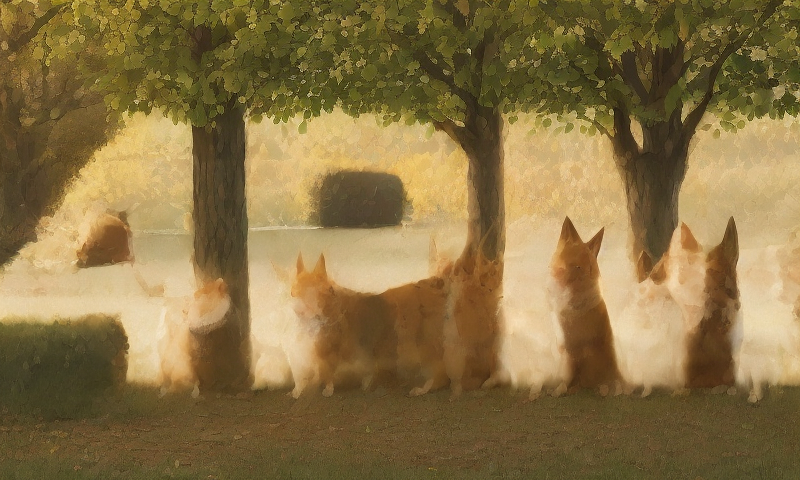

In [11]:
ctlpipe(
    prompt="corgis in the park at golden hour",
    negative_prompt="bad, ugly, wrong",
    image=mask_image,
    num_inference_steps=inference_steps,
    guidance_scale=8.0,
    output_type="pil",
    generator=torch.manual_seed(42),
    controlnet_conditioning_scale=0.8,
    height=image_size[1],
    width=image_size[0],
).images[0]

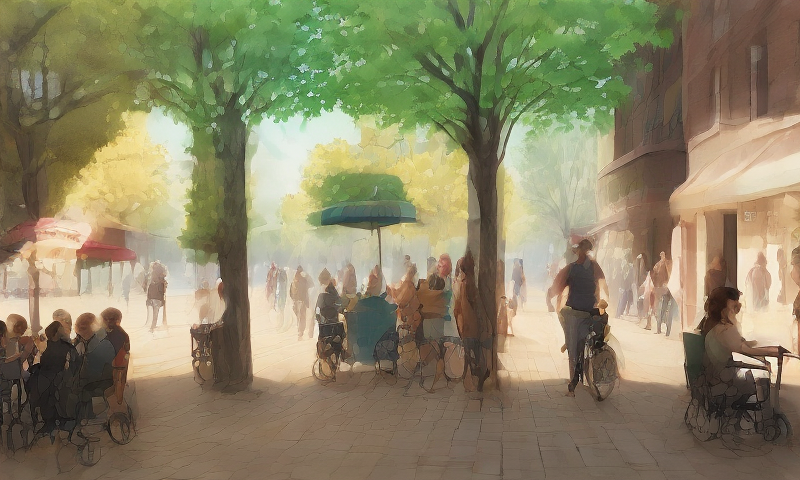

In [12]:
ctlpipe(
    prompt="watercolor of a leafy pedestrian mall at golden hour with multiracial genderqueer joggers and bicyclists and wheelchair users talking and laughing",
    negative_prompt="bad, ugly, wrong",
    image=mask_image,
    num_inference_steps=inference_steps,
    guidance_scale=8.0,
    output_type="pil",
    generator=torch.manual_seed(42),
    controlnet_conditioning_scale=0.7,
    height=image_size[1],
    width=image_size[0],
).images[0]

In [13]:
cali1 = "desert landscape with tall mountains and cactus and boulders at sunrise with the sun on the horizon"
cali2 = "stony river in a sunny redwood forest with salmon and deer and bears and mushrooms"
cali3 = "beach, tall cliffs, sun at the horizon, albatross eating fish, no one on the beach, boulders and tide pools in the shallow water"
cali4 = "nighttime photo of a desert landscape with the milky way in the sky and boulders on a shallow lake bed surrounded by tall mountains"

prompts = [
    cali1,
    cali2,
    cali3,
    cali4,
]


In [15]:
from tqdm import tqdm

In [16]:
iterations = 6 + 1

images = [make_image_grid(images=[
    ctlpipe(
        prompt=prompt,
        negative_prompt="bad, ugly, wrong",
        image=mask_img,
        num_inference_steps=inf_steps,
        guidance_scale=8.0,
        controlnet_conditioning_scale = conditioning_scale,
        generator=torch.manual_seed(42 + i),
        height = image_size[1],
        width=image_size[0]).images[0] if i > 0 else mask_image_factory(timestamp=None, mask_text=f"{conditioning_scale:.02f} @ {inf_steps}")
    for conditioning_scale in (np.arange(0,1.00001,0.05)) for i in range(iterations)
], cols=iterations, rows=21).reduce(2) for prompt in tqdm(prompts) for mask_img in [mask_image, ImageOps.invert(mask_image)] for inf_steps in [1,2]]
            

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [19:21:49<00:00, 17427.36s/it]


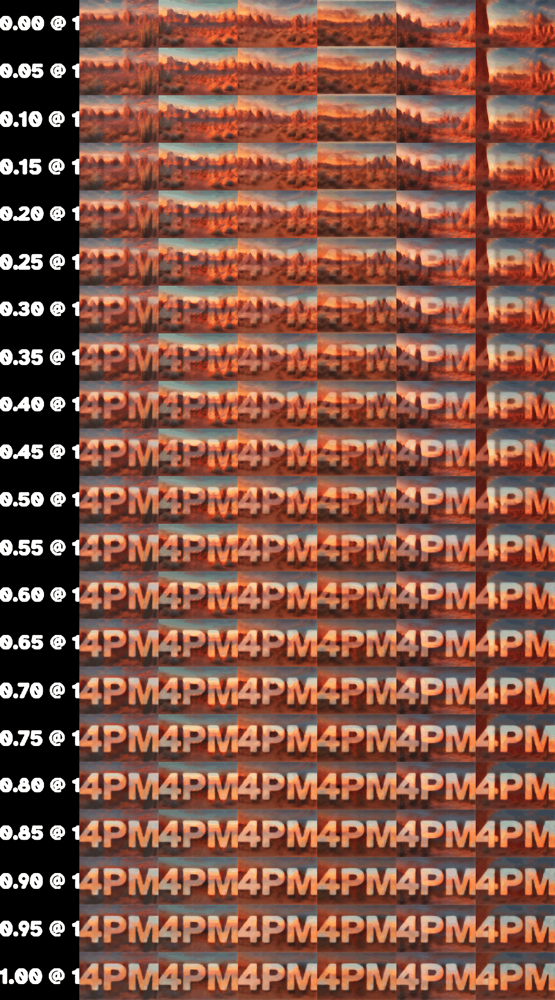

In [72]:
images[0].reduce(2).quantize()

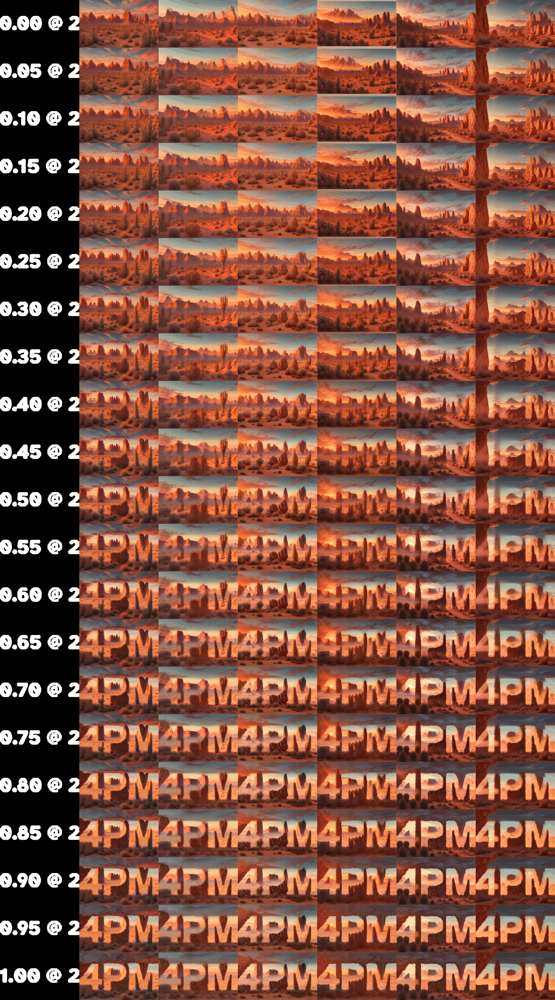

In [73]:
images[1].reduce(2).quantize()

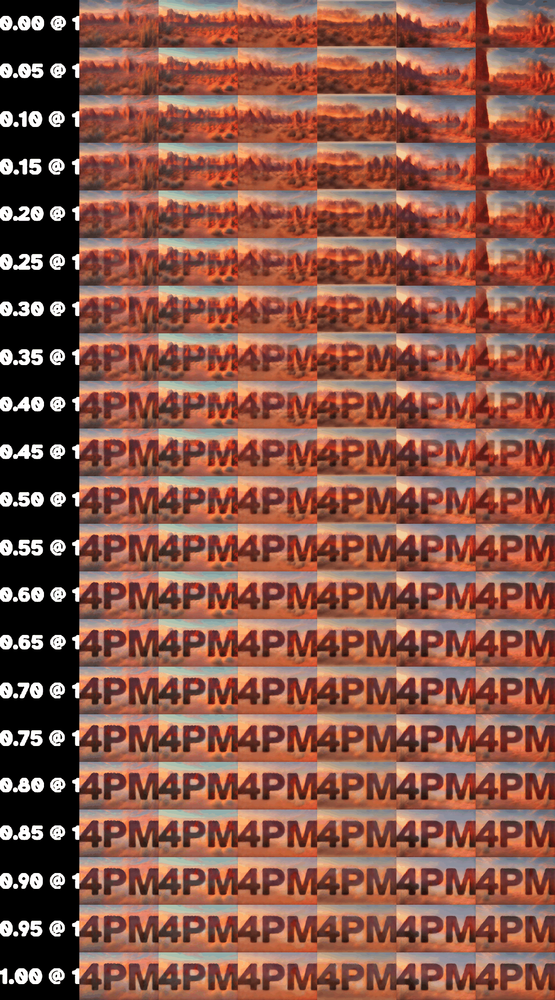

In [74]:
images[2].reduce(2).quantize()

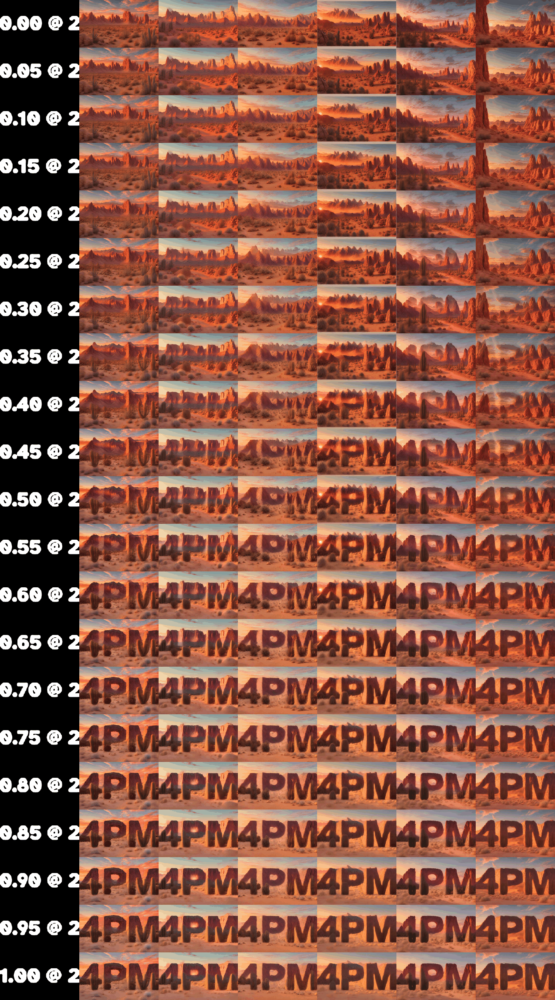

In [75]:
images[3].reduce(2).quantize()

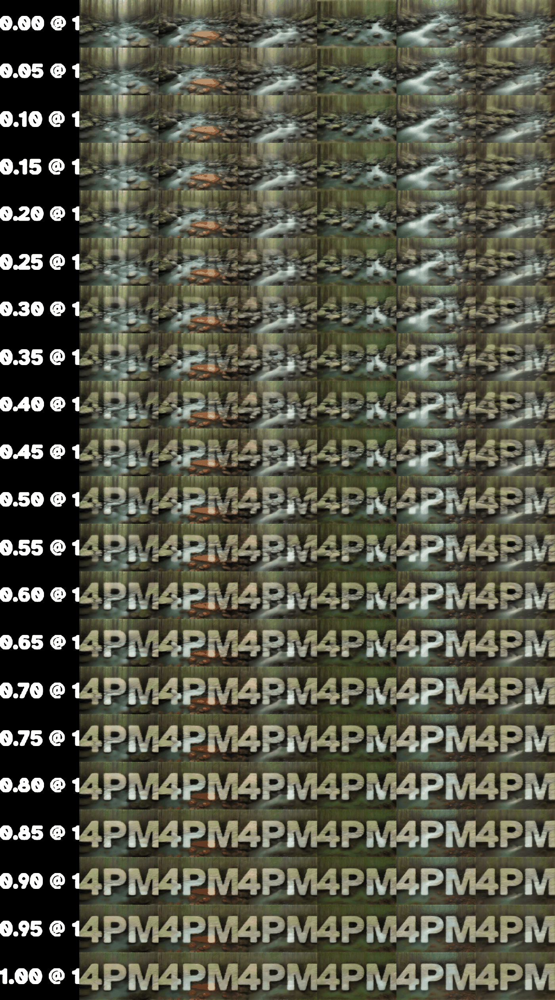

In [76]:
images[4].reduce(2).quantize()

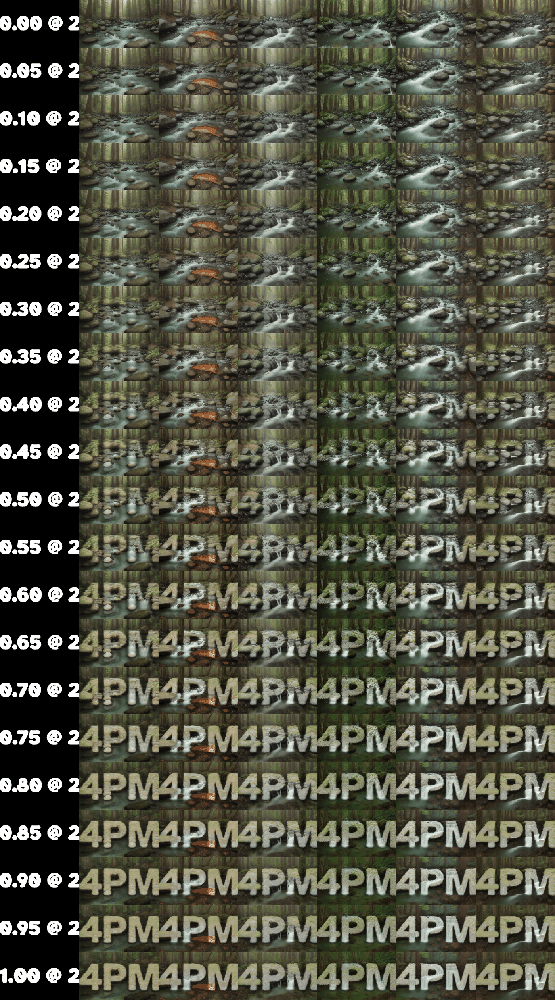

In [77]:
images[5].reduce(2).quantize()

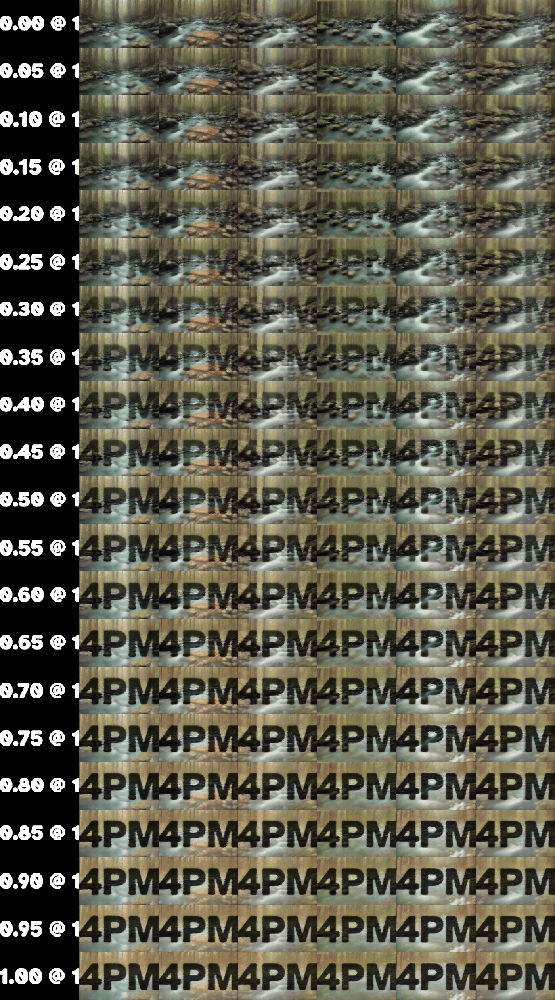

In [78]:
images[6].reduce(2).quantize()

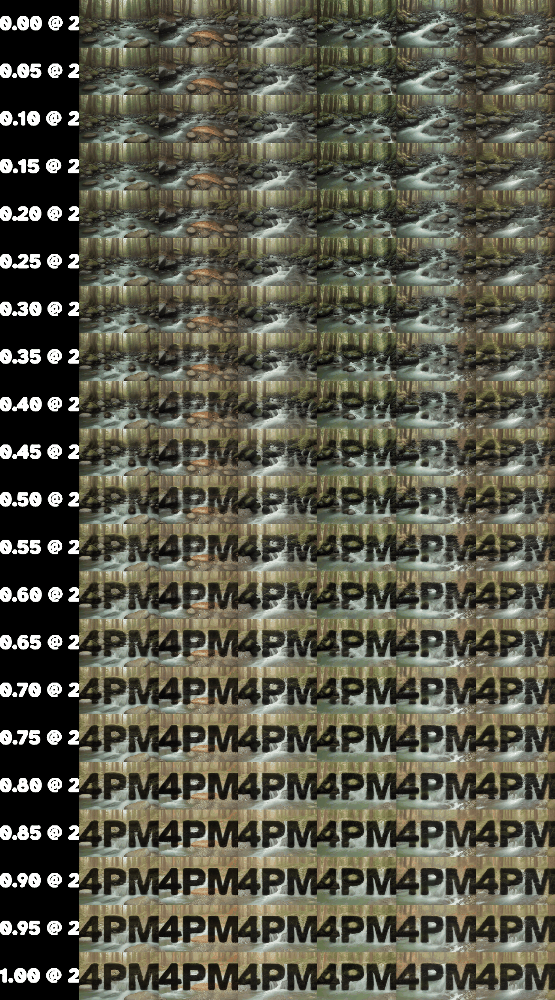

In [79]:
images[7].reduce(2).quantize()

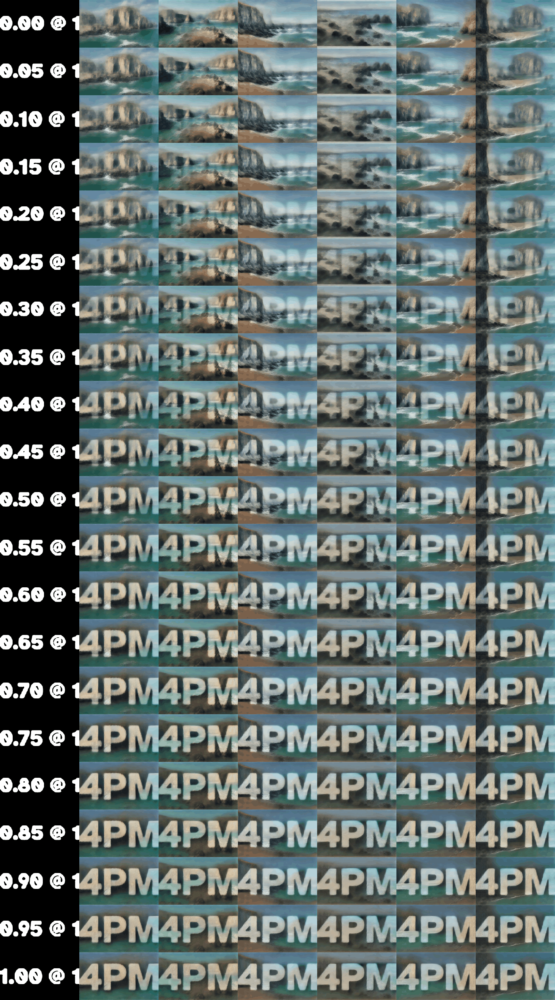

In [80]:
images[8].reduce(2).quantize()

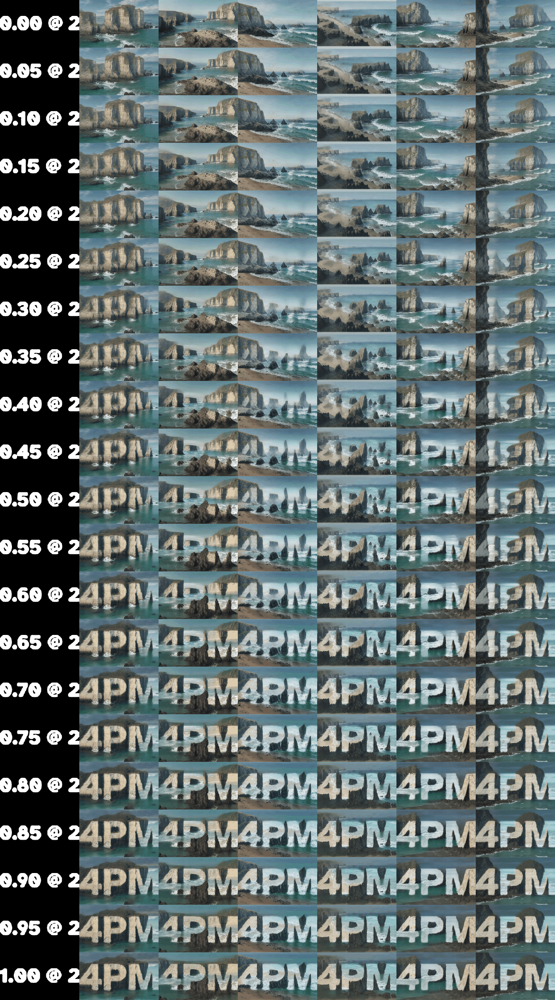

In [81]:
images[9].reduce(2).quantize()

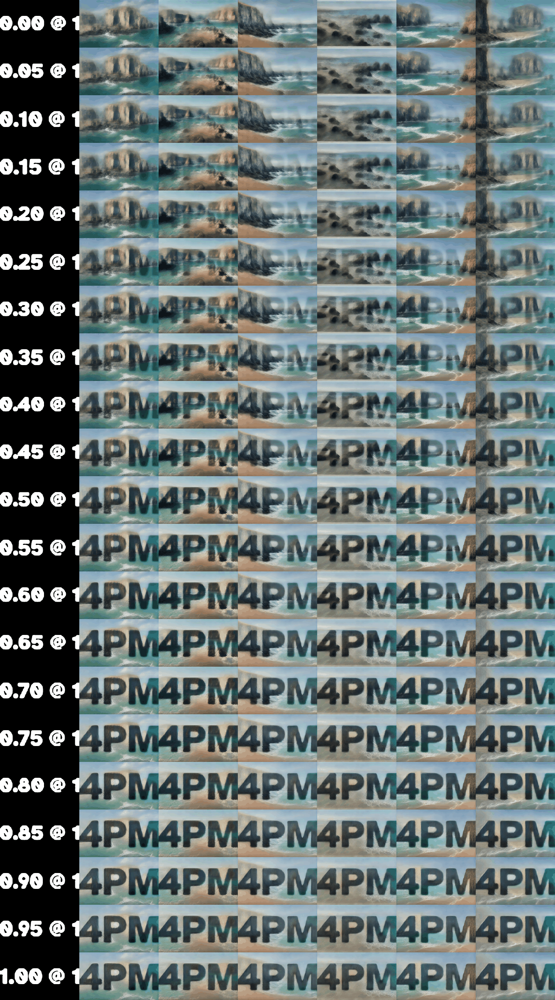

In [82]:
images[10].reduce(2).quantize()

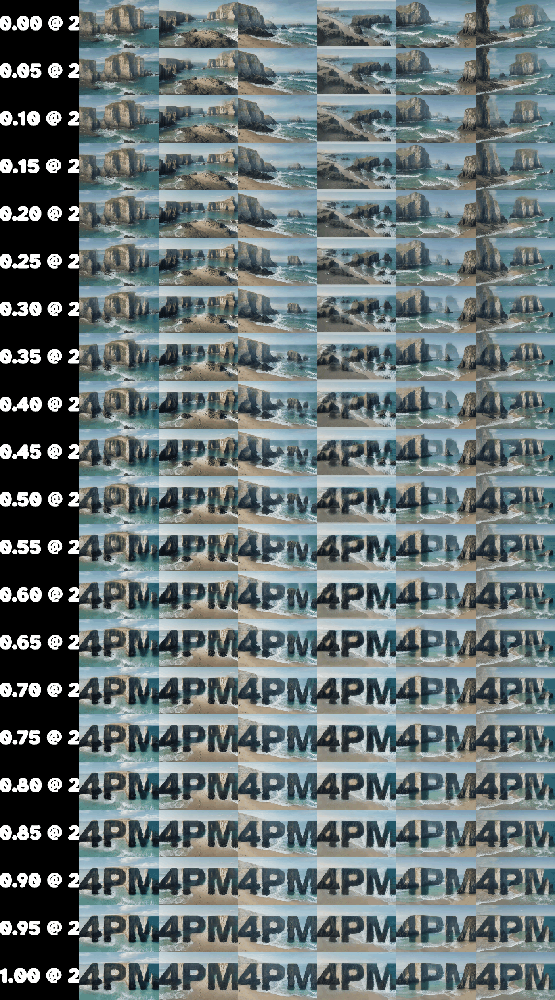

In [83]:
images[11].reduce(2).quantize()

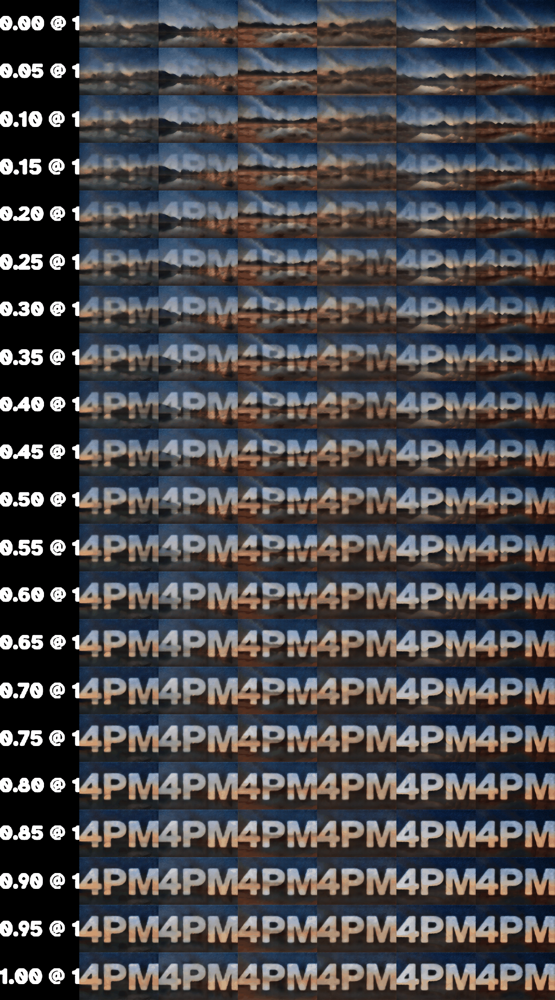

In [84]:
images[12].reduce(2).quantize()

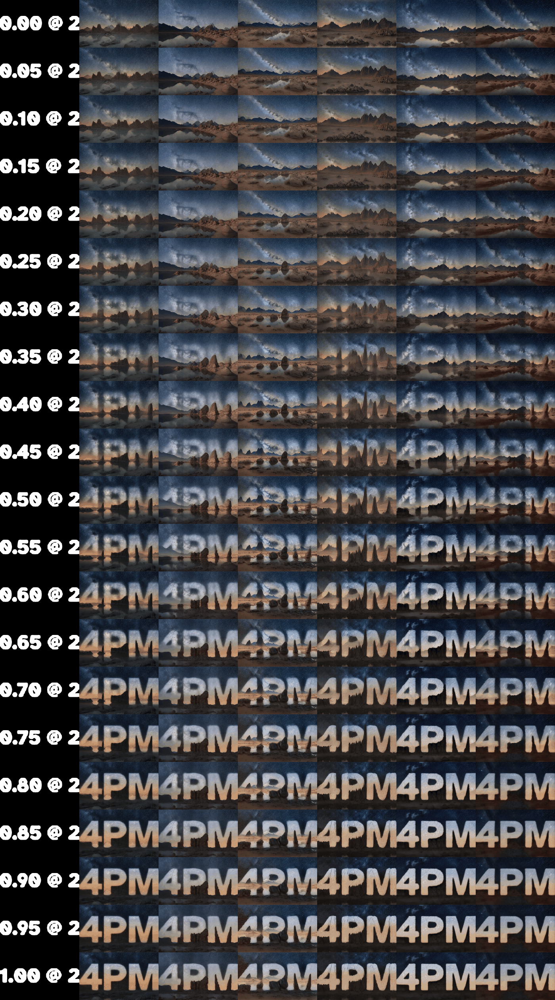

In [85]:
images[13].reduce(2).quantize()

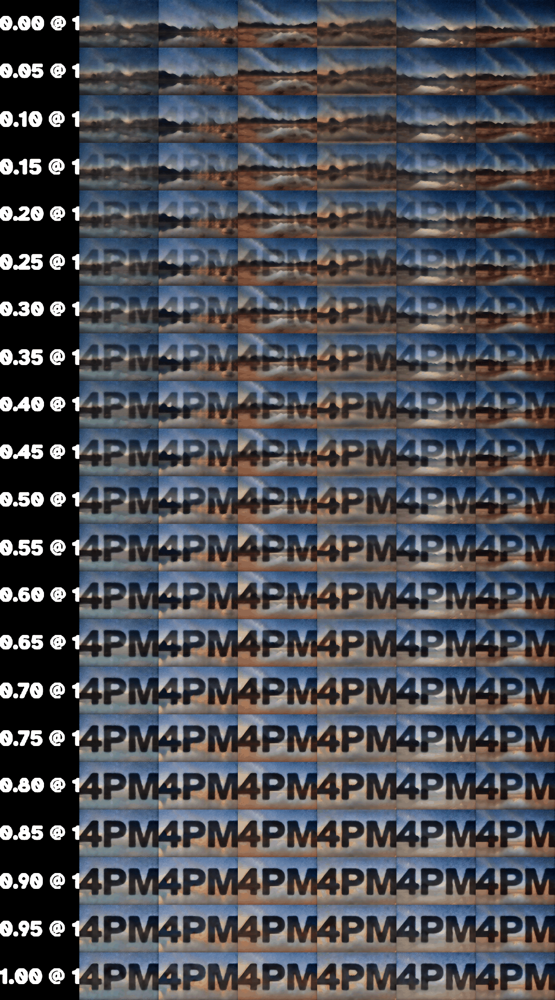

In [86]:
images[14].reduce(2).quantize()

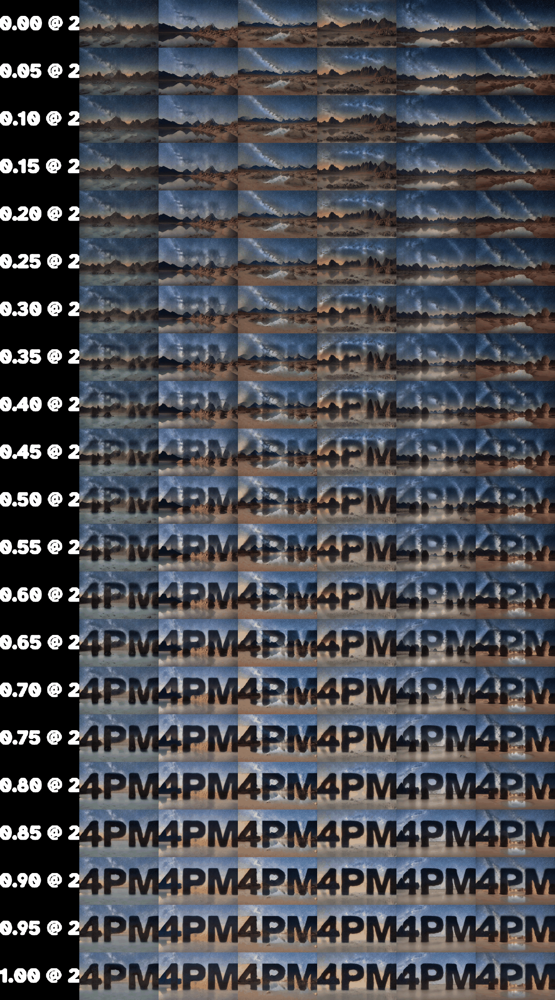

In [87]:
images[15].reduce(2).quantize()